In [20]:
from Postprocess_functions import *

In [21]:
import gmsh
import sys
import os
from os.path import exists
import subprocess
import numpy as np
import time
import ROOT
from os import listdir
from os.path import isfile, join
import os.path
from os import path
import matplotlib.pyplot as plt
import matplotlib.animation as animation
import argparse
from ROOT import TFile, TTree
import matplotlib.pyplot as plt
from scipy.interpolate import splrep, splev,splprep
from scipy.interpolate import BSpline
import math
def Initialization_Mult(args):
    print('Initializations')
    gen=[]
    gen_file=[]
    NSGA_files=[]
    root_folder=[]
    pictures_folder=[]
    pictures_folder_pareto=[]
    pictures_folder_filter=[]
    pictures_folder_filter_shape=[]
    
    c=0
    for fol in args.folder:
        root_folder.append(fol)
        gen.append(args.generation[c])
        print(gen)
        folder_path='ROOT/'+root_folder[c] # add path to ROOT/
        rf=os.listdir(folder_path)		# get all files in the folder
        NSGA_filenames = find_strings_containing_substring(rf, 'NSGAII_') # Get all root files
        print(rf)
        NSGA_filenames=sort_strings_by_int(NSGA_filenames)
        prefix = folder_path+'/'
        NSGA_files.append([prefix+s for s in NSGA_filenames])
        print(str(gen[c]))
        gen_file.append(folder_path+'/'+find_strings_containing_substring(rf, str(gen[c]))[0]) # Get last generation file or given gen.
        print('pictures/ROOT/'+root_folder[c]+'/Shape/')
        pictures_folder.append('pictures/ROOT/'+root_folder[c]+'/Shape/')
        print(pictures_folder)
        pictures_folder_pareto.append('pictures/ROOT/'+root_folder[c]+'/Pareto/')
        pictures_folder_filter.append('pictures/ROOT/'+root_folder[c]+'/Filter/')
        pictures_folder_filter_shape.append('pictures/ROOT/'+root_folder[c]+'/Filter/Shape_gen'+str(gen[c])+'/')

        create_folder(pictures_folder[c])  # Create required folders to store pictures
        create_folder(pictures_folder_pareto[c])  # Create required folders to store pictures
        create_folder(pictures_folder_filter[c])  # Create required folders to store pictures
        create_folder(pictures_folder_filter_shape[c])  # Create required folders to store pictures
        c+=1
        print('### Initializations END')
    return gen, gen_file, NSGA_files, root_folder, pictures_folder, pictures_folder_pareto, pictures_folder_filter, pictures_folder_filter_shape


In [ ]:
import matplotlib as mpl
pgf_with_latex = {                      # setup matplotlib to use latex for output
    "pgf.texsystem": "pdflatex",        # change this if using xetex or lautex
    "text.usetex": True,                # use LaTeX to write all text
    "font.family": "serif",
    "font.serif": [],                   # blank entries should cause plots 
    "font.sans-serif": [],              # to inherit fonts from the document
    "font.monospace": [],
    "axes.labelsize": 10,               # LaTeX default is 10pt font.
    "font.size": 10,
    "legend.fontsize": 8,               # Make the legend/label fonts 
    "xtick.labelsize": 8,               # a little smaller
    "ytick.labelsize": 8,
    #"figure.figsize": figsize(0.9),     # default fig size of 0.9 textwidth
    "pgf.preamble": "\n".join([ # plots will use this preamble
        r"\usepackage[utf8]{inputenc}",
        r"\usepackage[T1]{fontenc}",
        r"\usepackage[detect-all,locale=DE]{siunitx}",
        ])
    }
mpl.use("pgf")
mpl.rcParams.update(pgf_with_latex)

In [3]:
# Fill the class with the required inputs:

class ArgValues:
    def __init__(self):
        self.folder = ["G11_objLC_Acte_NoYSym_SiMP_375x3_68Evts_Spline_23-02-12"]
        self.generation = [13]
        self.Ysym = [1]
        self.LYSOL = [1]
        self.save = 1
        self.Shape = 0
        self.ParetoFrontier = 0
        self.Filter = 1
        self.LaunchIndv = 0
args0=ArgValues()

In [4]:
gen, gen_file, NSGA_files, root_folder, pictures_folder, pictures_folder_pareto, pictures_folder_filter, pictures_folder_filter_shape= Initialization_Mult(args0)
gen_file

Initializations
[13]
['NSGAII_3.root', 'NSGAII_11.root', 'NSGAII_2.root', 'NSGAII_0.root', 'NSGAII_5.root', 'NSGAII_12.root', 'NSGAII_8.root', 'NSGAII_7.root', 'NSGAII_13.root', 'NSGAII_4.root', 'NSGAII_9.root', 'NSGAII_10.root', 'NSGAII_1.root', 'NSGAII_6.root']
13
pictures/ROOT/G11_objLC_Acte_NoYSym_SiMP_375x3_68Evts_Spline_23-02-12/Shape/
['pictures/ROOT/G11_objLC_Acte_NoYSym_SiMP_375x3_68Evts_Spline_23-02-12/Shape/']
pictures/ROOT/G11_objLC_Acte_NoYSym_SiMP_375x3_68Evts_Spline_23-02-12/Shape/ already exists.
pictures/ROOT/G11_objLC_Acte_NoYSym_SiMP_375x3_68Evts_Spline_23-02-12/Pareto/ already exists.
pictures/ROOT/G11_objLC_Acte_NoYSym_SiMP_375x3_68Evts_Spline_23-02-12/Filter/ already exists.
pictures/ROOT/G11_objLC_Acte_NoYSym_SiMP_375x3_68Evts_Spline_23-02-12/Filter/Shape_gen13/ already exists.
### Initializations END


['ROOT/G11_objLC_Acte_NoYSym_SiMP_375x3_68Evts_Spline_23-02-12/NSGAII_13.root']

In [5]:
NSGA_files

[['ROOT/G11_objLC_Acte_NoYSym_SiMP_375x3_68Evts_Spline_23-02-12/NSGAII_0.root',
  'ROOT/G11_objLC_Acte_NoYSym_SiMP_375x3_68Evts_Spline_23-02-12/NSGAII_1.root',
  'ROOT/G11_objLC_Acte_NoYSym_SiMP_375x3_68Evts_Spline_23-02-12/NSGAII_2.root',
  'ROOT/G11_objLC_Acte_NoYSym_SiMP_375x3_68Evts_Spline_23-02-12/NSGAII_3.root',
  'ROOT/G11_objLC_Acte_NoYSym_SiMP_375x3_68Evts_Spline_23-02-12/NSGAII_4.root',
  'ROOT/G11_objLC_Acte_NoYSym_SiMP_375x3_68Evts_Spline_23-02-12/NSGAII_5.root',
  'ROOT/G11_objLC_Acte_NoYSym_SiMP_375x3_68Evts_Spline_23-02-12/NSGAII_6.root',
  'ROOT/G11_objLC_Acte_NoYSym_SiMP_375x3_68Evts_Spline_23-02-12/NSGAII_7.root',
  'ROOT/G11_objLC_Acte_NoYSym_SiMP_375x3_68Evts_Spline_23-02-12/NSGAII_8.root',
  'ROOT/G11_objLC_Acte_NoYSym_SiMP_375x3_68Evts_Spline_23-02-12/NSGAII_9.root',
  'ROOT/G11_objLC_Acte_NoYSym_SiMP_375x3_68Evts_Spline_23-02-12/NSGAII_10.root',
  'ROOT/G11_objLC_Acte_NoYSym_SiMP_375x3_68Evts_Spline_23-02-12/NSGAII_11.root',
  'ROOT/G11_objLC_Acte_NoYSym_SiMP_375

In [6]:
NSGA_files[0][1]

'ROOT/G11_objLC_Acte_NoYSym_SiMP_375x3_68Evts_Spline_23-02-12/NSGAII_1.root'

### Filter - PF
The number of vars per indv is :11
The number indv is :100
The number of vars per indv is :11
The number indv is :100
[72, 24, 9, 13, 67, 77, 2, 83, 73, 23, 65, 64, 84, 87, 27]


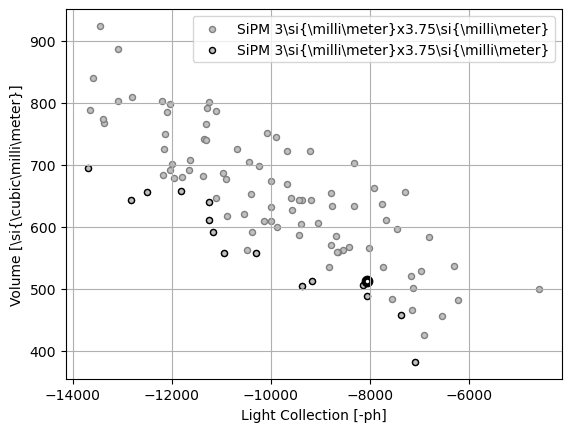

<Figure size 640x480 with 0 Axes>

In [7]:
	##############
	### FILTER ###
	##############
print('### Filter - PF')
fig1, ax1 = plt.subplots()

def plt_filtered_PF(fig1,ax1,gen_file,colorf,colore,lab='',mk='o'):
    # Get required input for plotting the crystal shapes
    num_indv,num_vars,obj1,obj2,vars_tuple,lstvars = GetRootVariables(gen_file)
    obj1f,obj2f,idxf=filter_values(obj1,obj2,20)
    print(idxf)
    #ax1.errorbar(obj1f,obj2f, fmt='o', capsize=3)
    ax1.scatter(obj1f,obj2f, s=19, c=colorf, edgecolor=colore, marker=mk,label=lab)
#    ax.errorbar(x, y, xerr=xerr, fmt='o', capsize=3)

def plt_nonfiltered_PF(fig1,ax1,gen_file,colorf,colore,lab='',mk='o'):
    # Get required input for plotting the crystal shapes
    num_indv,num_vars,obj1,obj2,vars_tuple,lstvars = GetRootVariables(gen_file)
    #obj1f,obj2f,idxf=filter_values(obj1,obj2,20)
    #print(idxf)
    #ax1.errorbar(obj1f,obj2f, fmt='o', capsize=3)
    ax1.scatter(obj1,obj2, s=19, c=colorf, edgecolor=colore, marker=mk,label=lab)
#    ax.errorbar(x, y, xerr=xerr, fmt='o', capsize=3)

plt.grid()
ax1.set_xlabel('Light Collection [-ph]')
ax1.set_ylabel('Volume [\\si{\cubic\milli\meter}]')
#plt.axhline(y = 3*3*28.5*2, color = 'k', linestyle = '--')
#plt.axhline(y = 2.4*3*28.5*2, color = 'k', linestyle = '--')
#plt.axhline(y = 3.75*3*28.5*2, color = 'k', linestyle = '--')
plt_nonfiltered_PF(fig1,ax1,NSGA_files[0][0],'silver','gray',lab='SiPM 3\\si{\milli\meter}x3.75\\si{\milli\meter}')
plt_filtered_PF(fig1,ax1,NSGA_files[0][0],'silver','black',lab='SiPM 3\\si{\milli\meter}x3.75\\si{\milli\meter}')

ax1.scatter([-8059],[513],s=30, c='white', edgecolor='black', marker='o',linewidths=3)
ax1.legend(bbox_to_anchor=(1.0, 1))

plt.show()
plt.draw()


In [8]:
plt.style.use('dark_background')


The number of vars per indv is :11
The number indv is :200
11
The number of vars per indv is :11
The number indv is :200
11
NoYSym
LYSOL
alpha <1
The number of vars per indv is :11
The number indv is :200
11
NoYSym
LYSOL


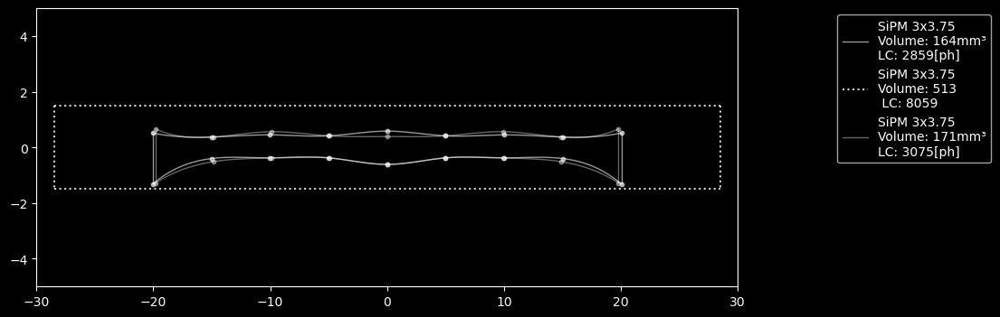

In [59]:

def crystalcoords_mult(gen_file,arg0,ind,vol,original_idx):
    
    num_indv,num_vars,obj1,obj2,vars_tuple,lstvars = GetRootVariables(gen_file[ind])
    print(num_vars)
    obj1f,obj2f,idxf=filter_values(obj1,obj2,40)
    Zhalf=28.5
    Yhalf=1.5
    #with original_idx as indv:	### optional variable arguments
    indv = original_idx
    ### get spline control points for different scenarions
    args=arg0
    legend_text='SiPM 3x3.75 \nVolume: '+str(int(obj2f[original_idx]))+'mm³'+'\nLC: '+str(int(-obj1f[original_idx]))+'[ph]'
    if(args.Ysym[ind]==1):
        print("NoYSym")
        if (args.LYSOL[ind]==1):
            print("LYSOL")
            #print("Length:",vars_tuple)
            xtop,ytop,xbot,ybot = SplinePts_NoYSym_L(num_vars-1,vars_tuple,Yhalf,indv)
        else:
            xtop,ytop,xbot,ybot = SplinePts_NoYSym(num_vars,vars_tuple,Zhalf,Yhalf,indv)				
    else:
        print("YSym")
        if (args.LYSOL[ind]==1):
            print("LYSOL")
            #print("Length:",vars_tuple)
            xtop,ytop,xbot,ybot = SplinePts_YSym_L(11-1,vars_tuple,Yhalf,indv)
        else:
            xtop,ytop,xbot,ybot = SplinePts_YSym(num_vars,vars_tuple,Yhalf,Zhalf,indv)
    return xtop,ytop,xbot,ybot,legend_text

# Get required input for plotting the crystal shapes
ind=0

num_indv,num_vars,obj1,obj2,vars_tuple,lstvars = GetRootVariables(gen_file[ind])
print(num_vars)
obj1f,obj2f,idxf=filter_values(obj1,obj2,40)
idvtot=len(obj1f)

def plot_line_from_points(x_points, y_points,fig,ax,colori='blue',lab='',lnstyle='--', lnwidth=1, alph=0.5,ms=10):
	if len(x_points) != len(y_points):
		raise ValueError("x_points and y_points must have the same length")
	if len(x_points) != len(set(x_points)):
		raise ValueError("x_points must have unique values")
	if min(x_points) >= max(x_points) or min(y_points) >= max(y_points):
		raise ValueError("xmin must be less than xmax, and ymin must be less than ymax")

	tck = splrep( x_points, y_points,s=0)
	x_new = np.linspace(min(x_points), max(x_points), num=100)
	y_new = splev(x_new, tck)
	ax.scatter(x_points, y_points,color=colori,s=ms,alpha=alph)
	ax.plot(x_new, y_new,color=colori,label=lab,linestyle=lnstyle, linewidth=lnwidth, alpha=alph)
	ax.set_xlim([-30, 30])
	ax.set_ylim([-5,5])
	#plt.show()

def Plt_Crystal(xtop,ytop,xbot,ybot,fig,ax,colori='blue',lab='',lnstyle='-', lnwidth=1, alph=0.5,ms=10):
	
		plot_line_from_points(xtop,ytop,fig,ax,colori=colori,lab=lab,lnstyle=lnstyle, lnwidth=lnwidth, alph=alph,ms=ms)
		plot_line_from_points(xbot,ybot,fig,ax,colori=colori,lnstyle=lnstyle, lnwidth=lnwidth, alph=alph,ms=ms)
		ax.plot([xbot[0], xbot[0]],[ybot[0],ytop[0]], color=colori,linestyle=lnstyle, linewidth=lnwidth, alpha=alph)
		ax.plot([xbot[-1], xbot[-1]],[ybot[-1],ytop[-1]], color=colori,linestyle=lnstyle, linewidth=lnwidth, alpha=alph)


def plot_crystal(idx, alph,gen_file,idxs=0):
    leg=[]
    #fig1, ax1 = plt.subplots()
    fig_width = 30 # Set the desired figure width here
    fig_height = 5  # Set the desired figure height here
    fig1, ax1 = plt.subplots(figsize=(fig_width, fig_height))
    xtop,ytop,xbot,ybot,legend_text = crystalcoords_mult(gen_file,args0,0,513,idx)
    Plt_Crystal(xtop,ytop,xbot,ybot,fig1,ax1,'white',lab=legend_text,
               lnstyle='-', lnwidth=1, alph=alph)
    leg.append(legend_text)

    Plt_DefaultCrystal(fig1,ax1,colori='lightgray',ls='dotted')
    if (alph<1):
        print("alpha <1")
        xtop,ytop,xbot,ybot,legend_text = crystalcoords_mult(gen_file,args0,0,513,idx+1)
        Plt_Crystal(xtop,ytop,xbot,ybot,fig1,ax1,'white',lab=legend_text,
                   lnstyle='-', lnwidth=1, alph=1-alph)
        
    ax1.legend(bbox_to_anchor=(1.37, 1.0))
    plt.savefig(f"movieIM_geom/picture_geom_{idxs}.png", bbox_inches='tight')


plot_crystal(0, 0.6,gen_file)

The number of vars per indv is :11
The number indv is :200
11
The number of vars per indv is :11
The number indv is :200
11
NoYSym
LYSOL
The number of vars per indv is :11
The number indv is :200
11
NoYSym
LYSOL
alpha <1
The number of vars per indv is :11
The number indv is :200
11
NoYSym
LYSOL
The number of vars per indv is :11
The number indv is :200
11
NoYSym
LYSOL
alpha <1
The number of vars per indv is :11
The number indv is :200
11
NoYSym
LYSOL
The number of vars per indv is :11
The number indv is :200
11
NoYSym
LYSOL
alpha <1
The number of vars per indv is :11
The number indv is :200
11
NoYSym
LYSOL
The number of vars per indv is :11
The number indv is :200
11
NoYSym
LYSOL
alpha <1
The number of vars per indv is :11
The number indv is :200
11
NoYSym
LYSOL
The number of vars per indv is :11
The number indv is :200
11
NoYSym
LYSOL
alpha <1
The number of vars per indv is :11
The number indv is :200
11
NoYSym
LYSOL
The number of vars per indv is :11
The number indv is :200
11
NoYSym

/tmp/ipykernel_89444/1609528135.py:69: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig1, ax1 = plt.subplots(figsize=(fig_width, fig_height))


The number of vars per indv is :11
The number indv is :200
11
NoYSym
LYSOL
The number of vars per indv is :11
The number indv is :200
11
NoYSym
LYSOL
alpha <1
The number of vars per indv is :11
The number indv is :200
11
NoYSym
LYSOL
The number of vars per indv is :11
The number indv is :200
11
NoYSym
LYSOL
alpha <1
The number of vars per indv is :11
The number indv is :200
11
NoYSym
LYSOL
The number of vars per indv is :11
The number indv is :200
11
NoYSym
LYSOL
alpha <1
The number of vars per indv is :11
The number indv is :200
11
NoYSym
LYSOL
The number of vars per indv is :11
The number indv is :200
11
NoYSym
LYSOL
alpha <1
The number of vars per indv is :11
The number indv is :200
11
NoYSym
LYSOL
The number of vars per indv is :11
The number indv is :200
11
NoYSym
LYSOL
alpha <1
The number of vars per indv is :11
The number indv is :200
11
NoYSym
LYSOL
The number of vars per indv is :11
The number indv is :200
11
NoYSym
LYSOL
alpha <1
The number of vars per indv is :11
The number 

IndexError: list index out of range

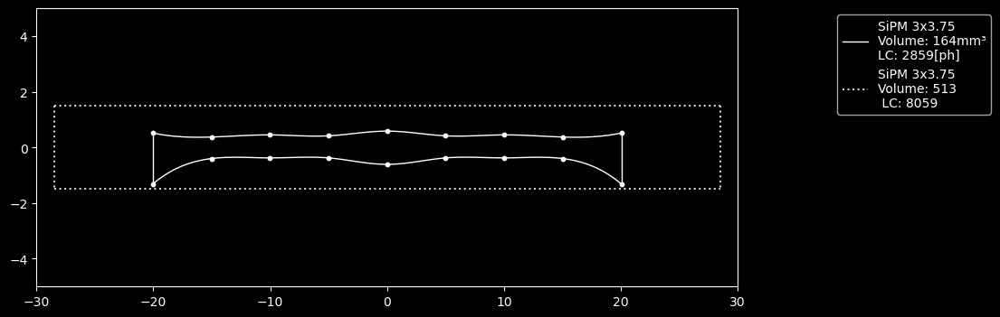

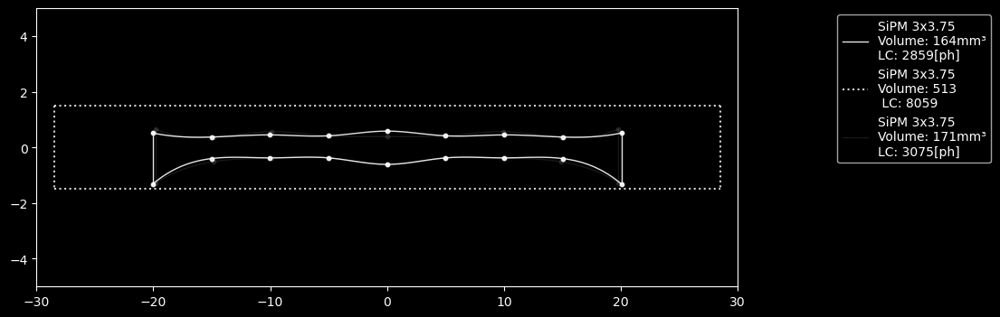

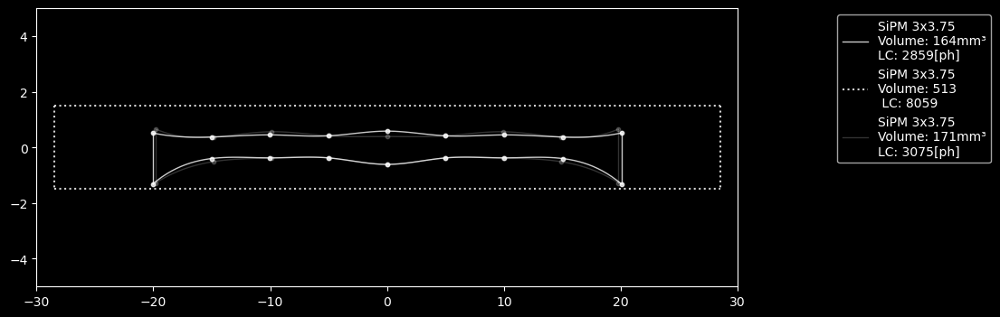

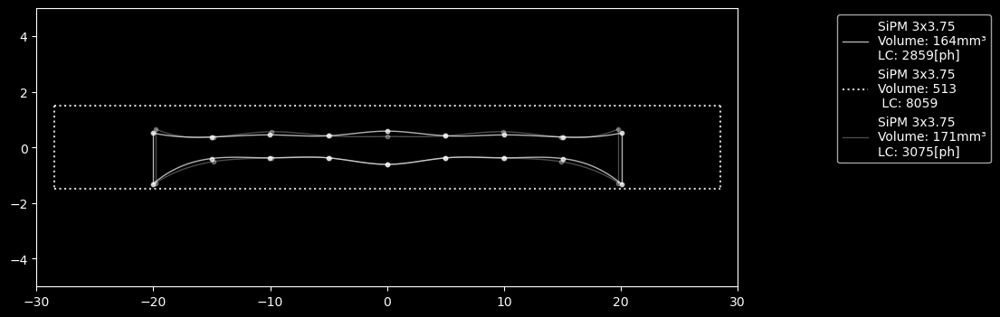

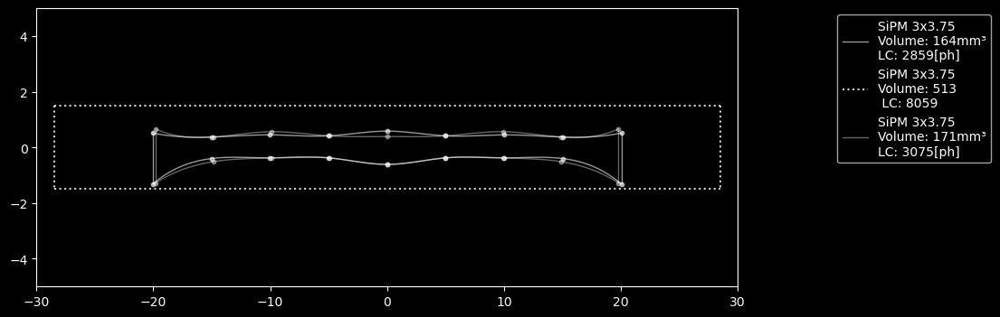

...

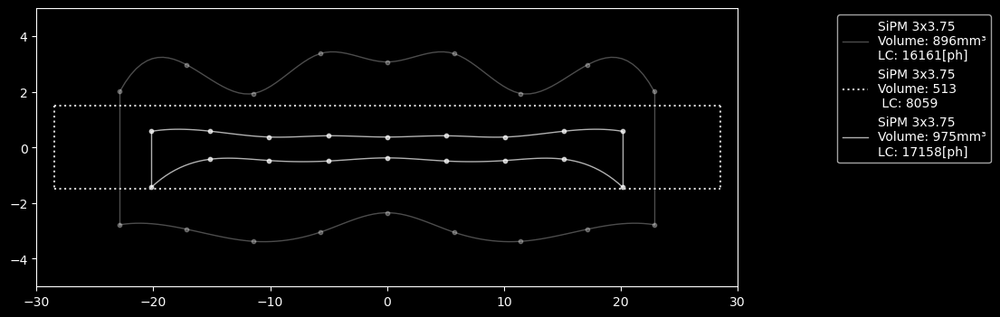

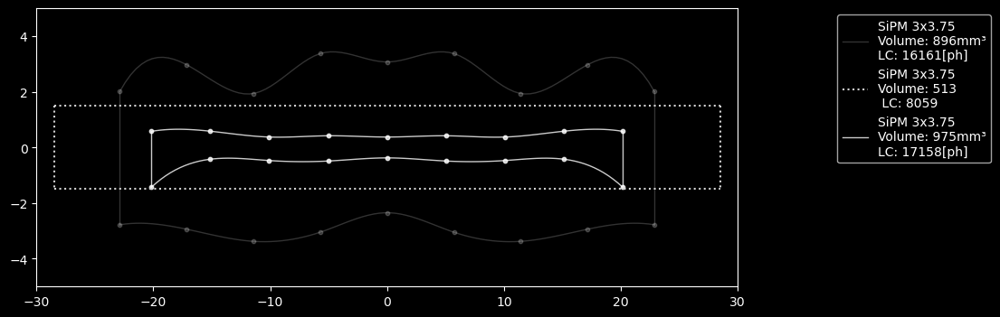

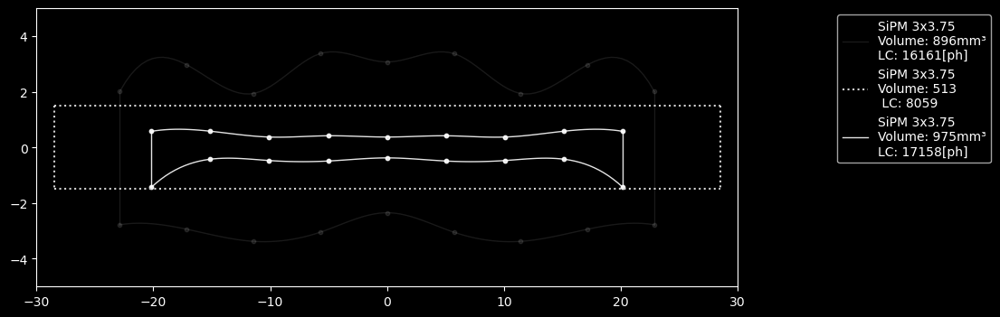

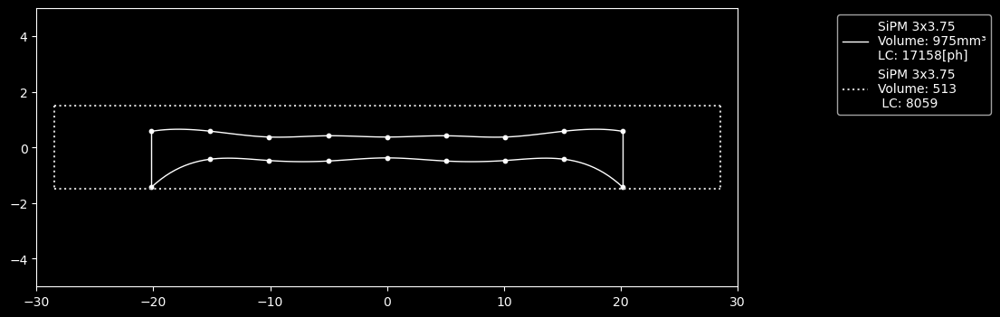

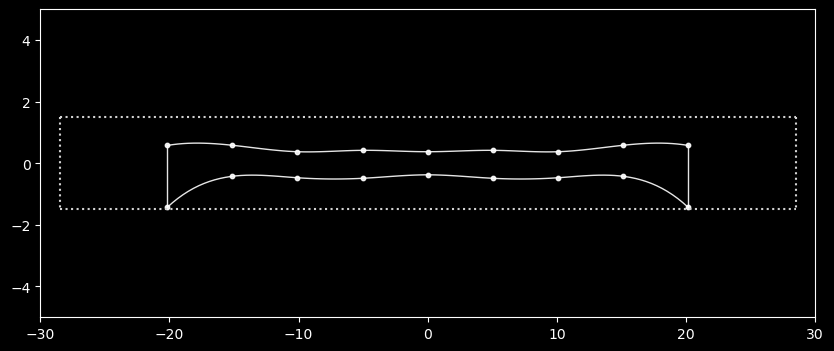

In [60]:
# Get required input for plotting the crystal shapes
ind=0

num_indv,num_vars,obj1,obj2,vars_tuple,lstvars = GetRootVariables(gen_file[ind])
print(num_vars)
obj1f,obj2f,idxf=filter_values(obj1,obj2,40)
idvtot=len(obj1f)
idxs=1000
for nsga_file_idx in range(idvtot):
    for alpha in np.arange(1.0, 0.0, -0.1):
        plot_crystal(nsga_file_idx, alpha, gen_file,idxs)
        idxs+=1
